In [1]:
from tqdm.notebook import tqdm
import numpy as np
from numba import jit
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np
from numba import jit
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


## 1. Базове рівняння (2D мембрана)

$$
\frac{\partial^2 U}{\partial t^2}
= c^2\left( \frac{\partial^2 U}{\partial x^2} + \frac{\partial^2 U}{\partial y^2} \right),
$$

де $U(x,y,t)$ — зміщення мембрани, $c$ — швидкість хвилі.

---

## 2. Дискретизація простору та часу

Беремо рівномірну сітку:

$$
x_i = i\,\Delta x,\quad y_j = j\,\Delta y,\quad t^k = k\,\Delta t,
$$

і позначаємо

$$
U_{i,j}^k \approx U(x_i, y_j, t^k).
$$

---

## 3. Різницеві апроксимації похідних

**Друга похідна за часом (центральна різниця):**

$$
\frac{\partial^2 U}{\partial t^2}\Big|_{i,j}^k
\approx \frac{U_{i,j}^{k+1} - 2U_{i,j}^k + U_{i,j}^{k-1}}{\Delta t^2}.
$$

**Друга похідна за $x$:**

$$
\frac{\partial^2 U}{\partial x^2}\Big|_{i,j}^k
\approx \frac{U_{i-1,j}^k - 2U_{i,j}^k + U_{i+1,j}^k}{\Delta x^2}.
$$

**Друга похідна за $y$:**

$$
\frac{\partial^2 U}{\partial y^2}\Big|_{i,j}^k
\approx \frac{U_{i,j-1}^k - 2U_{i,j}^k + U_{i,j+1}^k}{\Delta y^2}.
$$

---

## 4. Схема Кранка–Ніколсона

Для підвищення стійкості беремо середнє між лапласіаном у моменти $k+1$ і $k-1$:


\begin{aligned}
\frac{U_{i,j}^{k+1} - 2U_{i,j}^{k} + U_{i,j}^{k-1}}{\Delta t^2}
&= \frac{c^2}{2}\Bigg(
\frac{U_{i-1,j}^{k+1} - 2U_{i,j}^{k+1} + U_{i+1,j}^{k+1}}{\Delta x^2}
+ \frac{U_{i,j-1}^{k+1} - 2U_{i,j}^{k+1} + U_{i,j+1}^{k+1}}{\Delta y^2} \\
&\quad+
\frac{U_{i-1,j}^{k-1} - 2U_{i,j}^{k-1} + U_{i+1,j}^{k-1}}{\Delta x^2}
+ \frac{U_{i,j-1}^{k-1} - 2U_{i,j}^{k-1} + U_{i,j+1}^{k-1}}{\Delta y^2}
\Bigg).
\end{aligned}


---

## 5. Алгебраїчне рівняння для вузла $(i,j)$

Після впорядкування членів при $U^{k+1}$:

$$
b\,U_{i,j}^{k+1}
- a_x\,U_{i-1,j}^{k+1}
- c_x\,U_{i+1,j}^{k+1}
- a_y\,U_{i,j-1}^{k+1}
- c_y\,U_{i,j+1}^{k+1}
= -\,d_{rhs,\,i,j},
$$

де коефіцієнти:

$$
a_x = c_x = \frac{c^2}{2\,\Delta x^2}, \qquad
a_y = c_y = \frac{c^2}{2\,\Delta y^2}, \qquad
b = \frac{1}{\Delta t^2} + a_x + c_x + a_y + c_y,
$$

а права частина визначається так само, як у коді:

$$
d_{rhs,\,i,j} =
\frac{-2U_{i,j}^{k} + U_{i,j}^{k-1}}{\Delta t^2}
-\frac{c^2}{2}\left(
\frac{U_{i-1,j}^{k-1} - 2U_{i,j}^{k-1} + U_{i+1,j}^{k-1}}{\Delta x^2}
+
\frac{U_{i,j-1}^{k-1} - 2U_{i,j}^{k-1} + U_{i,j+1}^{k-1}}{\Delta y^2}
\right).
$$

---

## 6. Метод релаксації для розв’язання системи
У нас є лінійна система:
$$
bU_{i,j} + a_xU_{i-1,j} + c_xU_{i+1,j} + a_yU_{i,j-1} + c_yU_{i,j+1} = -d_{rhs,\,i,j}.
$$

Якщо розв’язати щодо $U_{i,j}$:
$$
U_{i,j} =\frac{a_x(U_{i-1,j} + U_{i+1,j}) +a_y(U_{i,j-1} + U_{i,j+1})- d_{rhs,\,i,j}  }{  b  }.
$$

Оновлення вузла $(i,j)$:

$$
U_{i,j}^{(new)} = (1-\omega)\,U_{i,j}^{(old)} +
\omega \cdot
\frac{
a_x(U_{i-1,j} + U_{i+1,j}) +
a_y(U_{i,j-1} + U_{i,j+1})
- d_{rhs,\,i,j}
}{
b
},
$$

де параметр релаксації $0<\omega<2$ (у коді `alfa`).


In [5]:
@jit(nopython=True, fastmath=True, cache=True)
def relax(ax, ay, cx, cy, b, d_rhs, n, m, U, alfa=1.84, eps=1e-13, max_iter=10_000):
    err = 1.0
    it = 0
    inv_b = 1.0 / b # 25% faster
    while err > eps and it < max_iter:
        it += 1
        err = 0.0
        # внутрішні вузли (i=1..n-2, j=1..m-2)
        for i in range(1, n-1):
            for j in range(1, m-1):
                t = (ax[i, j] * U[i-1, j] + cx[i, j] * U[i+1, j] +
                     ay[i, j] * U[i, j-1] + cy[i, j] * U[i, j+1] -
                     d_rhs[i, j]) * inv_b[i,j]
                deviation = abs(U[i, j] - t)
                err = max(err, deviation)
                U[i, j] = t * alfa + U[i, j] * (1 - alfa)
    return U

In [59]:
# 'FREE_CENTER'          – вільні краї (Неймана), одне центральне джерело
# 'FREE_TWO_GENERATORS'  – вільні краї (Неймана), два джерела зліва/справа
# 'CLAMPED_CENTER'       – закріплені краї (Діріхле), одне центральне джерело
experiment_type = 'FREE_CENTER'

# --- параметри та сітка ---
nx = 201
ny = 201
Lx = 10.0
Ly = 10.0
hx = Lx/(nx-1)
hy = Ly/(ny-1)

x = np.linspace(0.0, Lx, nx)
y = np.linspace(0.0, Ly, ny)

AA = 1e-4   # амплітуда
KK = 2     # частота у sin(pi*KK*k*dt)
dt = 1e-2   # крок часу

# --- шари розв'язку ---
U  = np.zeros((nx, ny))   # поточний
U0 = U.copy()             # k-1
U1 = U.copy()             # k після ініціалізації
dU = U.copy()             # початкові швидкості = 0

# формування другого шару (U1) як U0 + dt * dU
U1[1:nx-1, 1:ny-1] = U0[1:nx-1, 1:ny-1] + dt * dU[1:nx-1, 1:ny-1]

# --- базові (НЕмодифіковані) різницеві коефіцієнти ---
ax0 = 0.5 * np.ones((nx, ny)) / (hx**2)
cx0 = ax0.copy()
ay0 = 0.5 * np.ones((nx, ny)) / (hy**2)
cy0 = ay0.copy()
b0  = ax0 + cx0 + ay0 + cy0 + 1.0/(dt**2)



# функції-утиліти
def apply_neumann_coeff_mods(b, ax, ay, cx, cy):
    """Модифікації коефіцієнтів для Неймана (вільні краї)."""
    # нижня межа j=1
    b[:, 1]  = b[:, 1] - ay[:, 1]
    ay[:, 1] = 0.0
    # верхня межа j=ny-2
    b[:, ny-2]  = b[:, ny-2] - cy[:, ny-2]
    cy[:, ny-2] = 0.0
    # ліва межа i=1
    b[1, :]  = b[1, :] - ax[1, :]
    ax[1, :] = 0.0
    # права межа i=nx-2
    b[nx-2, :]  = b[nx-2, :] - cx[nx-2, :]
    cx[nx-2, :] = 0.0

def copy_neumann_boundaries(U):
    """Копіювання для Неймана (дзеркальна екстраполяція + кути)."""
    U[:, 0]    = U[:, 1]
    U[:, ny-1] = U[:, ny-2]
    U[0, :]    = U[1, :]
    U[nx-1, :] = U[nx-2, :]

    U[0, 0]          = 0.5*(U[1, 0]      + U[0, 1])
    U[nx-1, ny-1]    = 0.5*(U[nx-2, ny-1]+ U[nx-1, ny-2])
    U[0, ny-1]       = 0.5*(U[0, ny-2]   + U[1, ny-1])
    U[nx-1, 0]       = 0.5*(U[nx-1, 1]   + U[nx-2, 0])

def set_sources(k, ax, ay, cx, cy, b, d_rhs):
    """Встановлює джерела згідно з experiment_type"""
    if experiment_type in ('FREE_CENTER', 'CLAMPED_CENTER'):
        I = nx//2
        J = ny//2
        ax[I, J] = 0.0; ay[I, J] = 0.0; cx[I, J] = 0.0; cy[I, J] = 0.0
        b[I, J]  = 1.0
        d_rhs[I, J] = AA * np.sin(np.pi * KK * k * dt)

    elif experiment_type == 'FREE_TWO_GENERATORS':
        I_left  = 1
        I_right = nx - 2
        J_mid   = ny // 2

        # ліве джерело
        ax[I_left, J_mid] = 0.0; ay[I_left, J_mid] = 0.0
        cx[I_left, J_mid] = 0.0; cy[I_left, J_mid] = 0.0
        b[I_left, J_mid]  = 1.0
        d_rhs[I_left, J_mid] = AA * np.sin(np.pi * KK * k * dt)

        # праве джерело
        ax[I_right, J_mid] = 0.0; ay[I_right, J_mid] = 0.0
        cx[I_right, J_mid] = 0.0; cy[I_right, J_mid] = 0.0
        b[I_right, J_mid]  = 1.0
        d_rhs[I_right, J_mid] = AA * np.sin(np.pi * KK * k * dt)

    elif experiment_type == 'MOVING_SOURCE':
        I = nx // 2
        J = (k % (ny - 2 - 1)) + 1  # рух по y від 1 до ny-2
        ax[I, J] = 0.0; ay[I, J] = 0.0; cx[I, J] = 0.0; cy[I, J] = 0.0
        b[I, J]  = 1.0
        d_rhs[I, J] = AA * np.sin(np.pi * KK * k * dt)



    else:
        raise ValueError("Unknown experiment_type")

In [ ]:
# 'FREE_CENTER'          – вільні краї (Неймана), одне центральне джерело
# 'FREE_TWO_GENERATORS'  – вільні краї (Неймана), два джерела зліва/справа
# 'CLAMPED_CENTER'       – закріплені краї (Діріхле), одне центральне джерело
experiment_type = 'FREE_CENTER'
probes = [
    (int(3.5/hx), ny//2),   # попереду (за напрямком руху)
    (int(1.0/hx), ny//2),   # позаду
]
signals = [[], []]
# --- час ---
max_step = 1000
t = np.zeros(max_step + 2)
t[1] = dt

# для Хладні-пошуку (збереження кадрів)
U_stack = np.zeros((nx, ny, max_step), dtype=float)

# --- часовий цикл ---
for k in tqdm(range(1, max_step + 1)):
    t[k+1] = t[k] + dt

    # --- базові копії коефіцієнтів на крок ---
    ax = ax0.copy()
    ay = ay0.copy()
    cx = cx0.copy()
    cy = cy0.copy()
    b  = b0.copy()

    # --- побудова правої частини d_rhs ---
    d_rhs = np.zeros((nx, ny), dtype=float)
    d_rhs[1:nx-1, 1:ny-1] = ((-2.0*U1[1:nx-1, 1:ny-1] + U0[1:nx-1, 1:ny-1])/(dt**2)
                              - 0.5*(
                                 (U0[0:nx-2, 1:ny-1] - 2.0*U0[1:nx-1, 1:ny-1] + U0[2:nx, 1:ny-1])/(hx**2)
                               + (U0[1:nx-1, 0:ny-2] - 2.0*U0[1:nx-1, 1:ny-1] + U0[1:nx-1, 2:ny])/(hy**2)
                              ))

    # --- джерела ---
    set_sources(k, ax, ay, cx, cy, b, d_rhs)
    
    # --- граничні умови ---
    if experiment_type in ('FREE_CENTER', 'FREE_TWO_GENERATORS', 'MOVING_SOURCE'):
        # Неймана: модифікація коефіцієнтів
        apply_neumann_coeff_mods(b, ax, ay, cx, cy)
    elif experiment_type == 'CLAMPED_CENTER':
        # Діріхле: нічого не робимо — межі залишаться нульовими
        pass
    else:
        raise ValueError("Unknown experiment_type")

    # --- розв'язання СЛАР ---
    U = relax(ax, ay, cx, cy, b, d_rhs, nx, ny, U.copy(), alfa=1.8, eps=1e-13, max_iter=5000)

    # --- коригування меж ---
    if experiment_type in ('FREE_CENTER', 'FREE_TWO_GENERATORS', 'MOVING_SOURCE'):
        copy_neumann_boundaries(U)
    elif experiment_type == 'CLAMPED_CENTER':
        U[0, :] = 0.0; U[-1, :] = 0.0; U[:, 0] = 0.0; U[:, -1] = 0.0
    else:
        raise ValueError("Unknown experiment_type")

    # --- запис сигналів з пробників ---
    # у часовому циклі, після оновлення U:
    for p, (ii, jj) in enumerate(probes):
        signals[p].append(U[ii, jj])
    # --- збереження кадру ---
    U_stack[:, :, k-1] = U

    # --- прокрутка шарів ---
    U0 = U1.copy()
    U1 = U.copy()

    

100%|██████████| 1000/1000 [00:17<00:00, 57.87it/s]


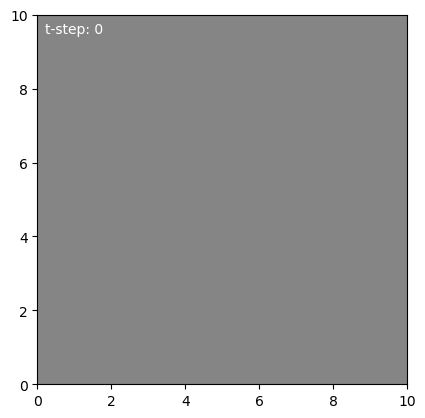

In [63]:
light_k = 2
U_stack_light = U_stack[..., ::light_k]          # [Nx, Ny, T]

# Готуємо кадри у форматі [T, Ny, Nx]:
frames = np.transpose(U_stack_light, (2, 1, 0))  # [T, Ny, Nx]
vmin, vmax = frames.min(), frames.max()

# Нормалізація в uint8 (разово)
if vmax > vmin:
    frames_u8 = ((frames - vmin) * (255.0 / (vmax - vmin))).astype(np.uint8)
else:
    frames_u8 = np.zeros_like(frames, dtype=np.uint8)

fig, ax = plt.subplots()
im = ax.imshow(frames_u8[0],
               origin='lower', cmap='gray',
               vmin=0, vmax=255,
               interpolation='nearest', animated=True,
               extent=[0, Lx, 0, Ly])
txt = ax.text(0.02, 0.95, '', transform=ax.transAxes, color='w')

def init():
    im.set_data(frames_u8[0])
    txt.set_text('t-step: 0')
    return im, txt

def update(i):
    im.set_data(frames_u8[i])
    txt.set_text(f"t-step: {i*light_k}")
    return im, txt

ani = FuncAnimation(fig, update, init_func=init,
                    frames=frames_u8.shape[0], interval=30*light_k, blit=True)

plt.show()

In [64]:
HTML(ani.to_jshtml())

In [58]:
#ani.save('membrane_animation_FREE_TWO_GENERATORS_2d.mp4', writer='ffmpeg', fps=30)

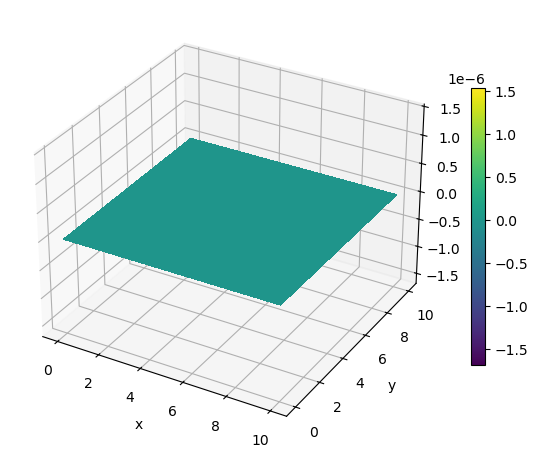

In [65]:
X, Y = np.meshgrid(x, y, indexing='ij')

ds = 2  # зменшення розміру сітки для швидкості
X_, Y_ = X[::ds, ::ds], Y[::ds, ::ds]
Z0 = U_stack_light[::ds, ::ds, 0]

vmin, vmax = U_stack_light.min(), U_stack_light.max()

fig = plt.figure(figsize=(7, 6))
ax = fig.add_subplot(111, projection='3d')

surf = [ax.plot_surface(X_, Y_, Z0, cmap='viridis',
                        linewidth=0, antialiased=False,
                        vmin=vmin, vmax=vmax)]
ax.set_zlim(vmin, vmax)
ax.set_xlabel('x'); ax.set_ylabel('y'); ax.set_zlabel('U')
fig.colorbar(surf[0], shrink=0.6, pad=0.05)

def update_3d(i):
    # прибрати стару поверхню
    surf[0].remove()
    Z = U_stack_light[::ds, ::ds, i]
    surf[0] = ax.plot_surface(X_, Y_, Z, cmap='viridis',
                              linewidth=0, antialiased=False,
                              vmin=vmin, vmax=vmax)
    ax.set_zticks([])
    ax.zaxis.set_ticklabels([])
    ax.set_title(f'Step {i*light_k}')
    return surf

ani_3d = FuncAnimation(fig, update_3d,
                       frames=U_stack_light.shape[2],
                       interval=30, blit=False)

plt.show()

In [66]:
from IPython.display import Video
ani_3d.save('membrane_animation_test.mp4', writer='ffmpeg', fps=30)

print("3D animation saved as membrane_animation_test.mp4")

3D animation saved as membrane_animation_test.mp4


In [67]:
Video("membrane_animation_test.mp4", embed=True, width=600)

# Free center

In [11]:
Video("membrane_animation_FREE_CENTER_2d.mp4", embed=True, width=600)

In [12]:
Video("membrane_animation_FREE_CENTER.mp4", embed=True, width=600)

# CLAMPED_CENTER

In [13]:
Video("membrane_animation_CLAMPED_CENTER_2d.mp4", embed=True, width=600)

In [14]:
Video("membrane_animation_CLAMPED_CENTER.mp4", embed=True, width=600)

# FREE_TWO_GENERATORS

In [15]:
Video("membrane_animation_FREE_TWO_GENERATORS_2d.mp4", embed=True, width=600)

In [16]:
Video("membrane_animation_FREE_TWO_GENERATORS.mp4", embed=True, width=600)

---